<a href="https://colab.research.google.com/github/codejack11/3d-models/blob/master/object_detection_cmac.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Mount Google Drive
mount and download dataset


In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# !unzip path_to_file.zip  -d path_to_destination
!unzip /content/drive/My\ Drive/ObjectDetection/dataset.zip -d /content/

In [ ]:
# #ignore this cell 

# import os
# for root, dirs, files in os.walk("/content/test/images", '*.jpg'):
#     for name in files:
#         os.remove(os.path.join(root, name))
#     for name in dirs:
#         os.rmdir(os.path.join(root, name))

# for root, dirs, files in os.walk("/content/test/labels", '*.txt'):
#     for name in files:
#         os.remove(os.path.join(root, name))
#     for name in dirs:
#         os.rmdir(os.path.join(root, name))

# for root, dirs, files in os.walk("/content/train/images", '*.jpg'):
#     for name in files:
#         os.remove(os.path.join(root, name))
#     for name in dirs:
#         os.rmdir(os.path.join(root, name))

# for root, dirs, files in os.walk("/content/train/labels", '*.txt'):
#     for name in files:
#         os.remove(os.path.join(root, name))
#     for name in dirs:
#         os.rmdir(os.path.join(root, name))

# for root, dirs, files in os.walk("/content/valid/images", '*.jpg'):
#     for name in files:
#         os.remove(os.path.join(root, name))
#     for name in dirs:
#         os.rmdir(os.path.join(root, name))

# for root, dirs, files in os.walk("/content/valid/labels", '*.txt'):
#     for name in files:
#         os.remove(os.path.join(root, name))
#     for name in dirs:
#         os.rmdir(os.path.join(root, name))

#Download repositories

## download yolo

> YOLOv5




In [2]:
!git clone https://github.com/ultralytics/yolov5  # clone repo
!pip install -qr yolov5/requirements.txt  # install dependencies (ignore errors)
%cd yolov5

Cloning into 'yolov5'...
remote: Enumerating objects: 7, done.
remote: Counting objects: 100% (7/7), done.
remote: Compressing objects: 100% (7/7), done.
remote: Total 2717 (delta 1), reused 0 (delta 0), pack-reused 2710
Receiving objects: 100% (2717/2717), 5.47 MiB | 34.57 MiB/s, done.
Resolving deltas: 100% (1795/1795), done.
     |████████████████████████████████| 276kB 5.3MB/s 
/content/yolov5


## Download Pytorch

> PyTorch



In [3]:
import torch
from IPython.display import Image, clear_output  # to display images
from utils.google_utils import gdrive_download  # to download models/datasets

clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Setup complete. Using torch 1.7.0+cu101 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15079MB, multi_processor_count=40)


## Dataset

> download dataset from https://app.ROBOFLOW.com



In [ ]:
#@title Default title text
# dataset from robolab
%cd /content
!curl -L "https://app.roboflow.com/ds/vC43tSXRwB?key=6qZ3dOra8o" > roboflow.zip; unzip roboflow.zip -d data/; rm roboflow.zip

# Preparation and visualization

In [42]:
%cat data.yaml

cat: data.yaml: No such file or directory


In [6]:
# define number of classes based on YAML
import yaml
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [7]:
#this is the model configuration we will use for our tutorial 
%cat /content/yolov5/models/yolov5x.yaml

# parameters
nc: 80  # number of classes
depth_multiple: 1.33  # model depth multiple
width_multiple: 1.25  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-

In [8]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))


In [9]:
%%writetemplate /content/yolov5/models/custom_yolov5x.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

#Training Model

In [44]:
# train yolov5s on custom data for 100 epochs
# time its performance
%%time
%cd /content/yolov5/
!python train.py --img 416 --batch 16 --epochs 100 --data '../data.yaml' --cfg ./models/yolov5x.yaml --weights 'yolov5x.pt' --name yolov5s_mayank --hyp /content/yolov5/data/hyp.finetune.yaml --device 0 --cache

/content/yolov5
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15079MB)

Namespace(adam=False, batch_size=16, bucket='', cache_images=True, cfg='./models/yolov5x.yaml', data='../data.yaml', device='0', epochs=100, evolve=False, global_rank=-1, hyp='/content/yolov5/data/hyp.finetune.yaml', image_weights=False, img_size=[416, 416], local_rank=-1, log_imgs=10, logdir='runs/', multi_scale=False, name='yolov5s_mayank', noautoanchor=False, nosave=False, notest=False, rect=False, resume=False, single_cls=False, sync_bn=False, total_batch_size=16, weights='yolov5x.pt', workers=8, world_size=1)
Start Tensorboard with "tensorboard --logdir runs/", view at http://localhost:6006/
2020-11-05 06:16:29.286833: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Install Weights & Biases for experiment logging via 'pip install wandb' (recommended)
Hyperparameters {'lr0': 0.0032, 'lrf': 0.12, 'momentum': 0.843, 'we

In [35]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
%cd /content/yolov5/runs/exp1_yolov5s_results/

[Errno 2] No such file or directory: '/content/yolov5/runs/exp1_yolov5s_results/'
/content/yolov5


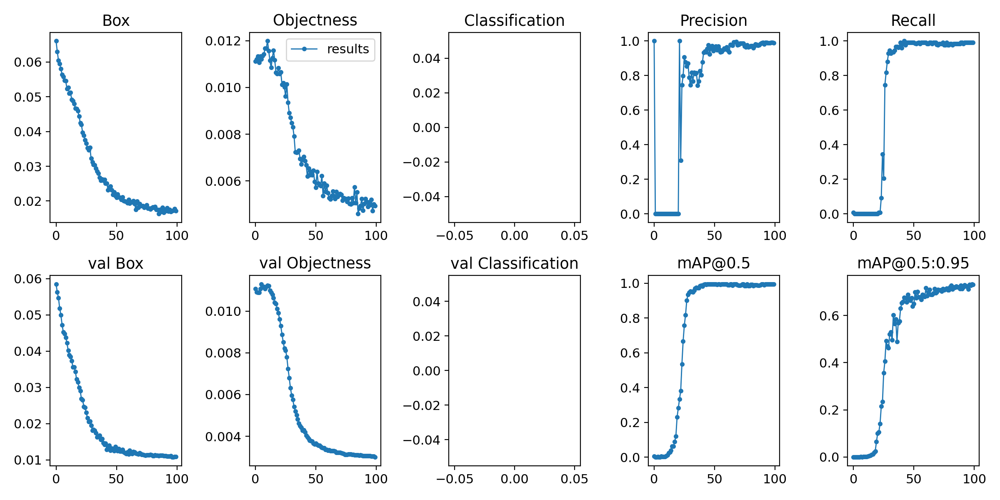

In [46]:
# # we can also output some older school graphs if the tensor board isn't working for whatever reason... 
# from utils.general import plot_results; plot_results()  # plot results.txt as results.png
Image(filename='/content/yolov5/runs/exp7_yolov5s_mayank/results.png', width=1000)  # view results.png

GROUND TRUTH TRAINING DATA:


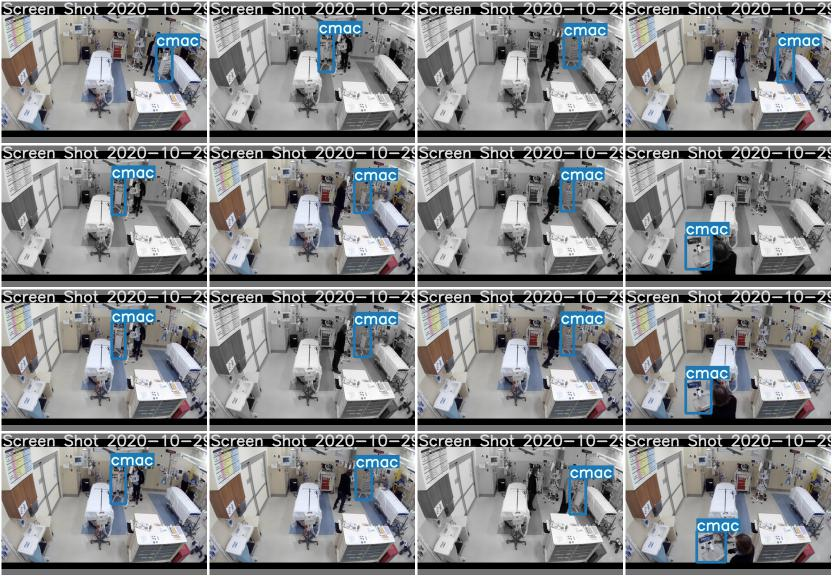

In [47]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/yolov5/runs/exp7_yolov5s_mayank/test_batch0_gt.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


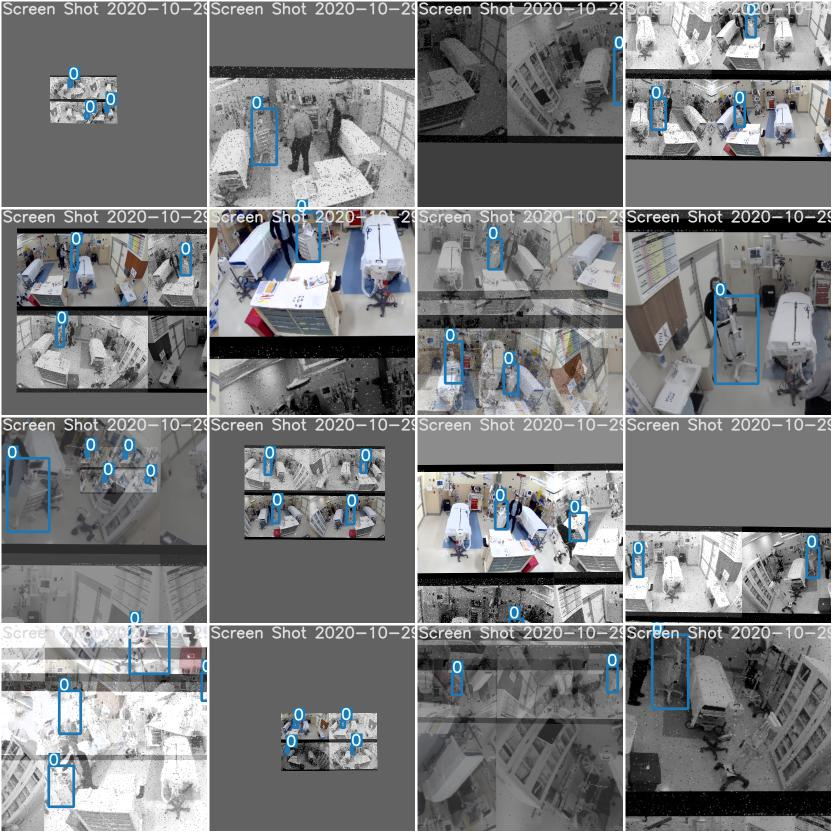

In [48]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/content/yolov5/runs/exp7_yolov5s_mayank/train_batch2.jpg', width=900)

In [ ]:
%cd /content/yolov5

In [45]:
# trained weights are saved by default in our weights folder
%ls runs/

exp0_yolov5s_mayank/  exp3_yolov5s_mayank/  exp6_yolov5s_mayank/
exp1_yolov5s_mayank/  exp4_yolov5s_mayank/  exp7_yolov5s_mayank/
exp2_yolov5s_mayank/  exp5_yolov5s_mayank/


# Test Model

In [49]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/yolov5/
!python detect.py --weights runs/exp7_yolov5s_mayank/weights/best.pt --img 416 --conf 0.09 --source /content/data/test/images

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.09, device='', img_size=416, iou_thres=0.45, save_conf=False, save_dir='inference/output', save_txt=False, source='/content/data/test/images', update=False, view_img=False, weights=['runs/exp7_yolov5s_mayank/weights/best.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15079MB)

Fusing layers... 
Model Summary: 284 layers, 8.83906e+07 parameters, 0 gradients
image 1/26 /content/data/test/images/Screen Shot 2020-10-29 at 19-04-10_png.rf.a77f83ea1fe30d2d4d262f9eb9845eee.jpg: 288x416 1 cmacs, Done. (0.033s)
image 2/26 /content/data/test/images/Screen Shot 2020-10-29 at 19-04-10_png.rf.c027de5c516b736ab6f9e55ef0a65cd6.jpg: 288x416 1 cmacs, Done. (0.031s)
image 3/26 /content/data/test/images/Screen Shot 2020-10-29 at 19-05-04_png.rf.c47461a9609a126d42258c47eabf9550.jpg: 288x416 1 cmacs, Done. (0.031s)
image 4/26 /content/data/test/images/Screen Shot 2020-10-29 at 19-05-04_png.

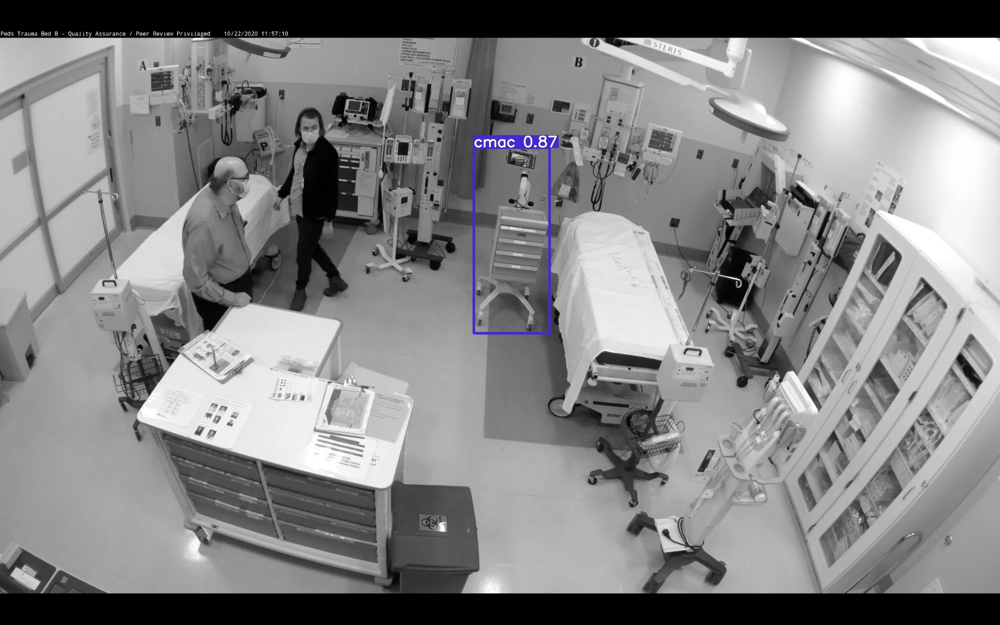

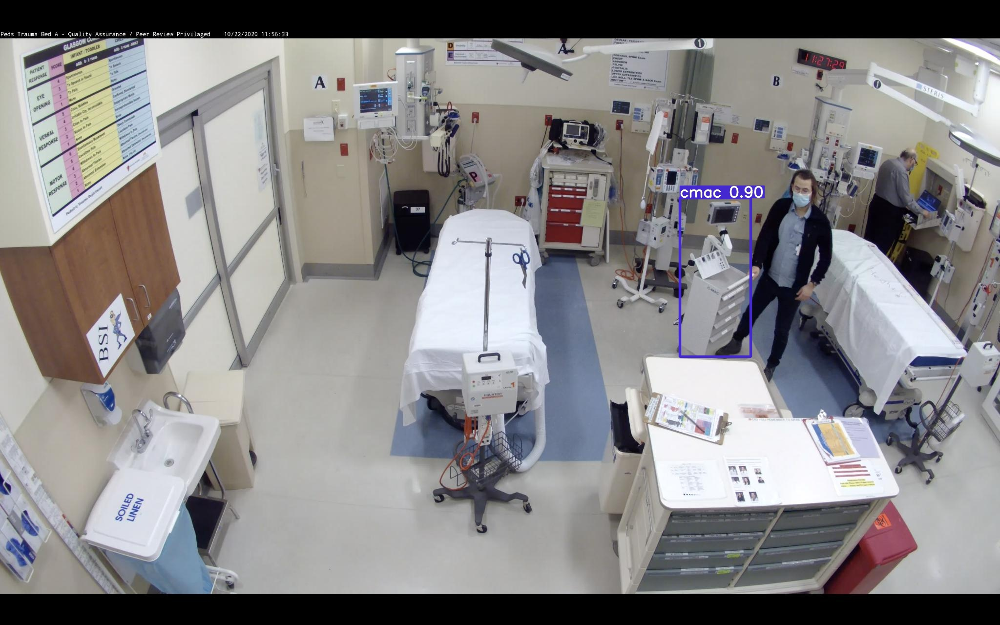

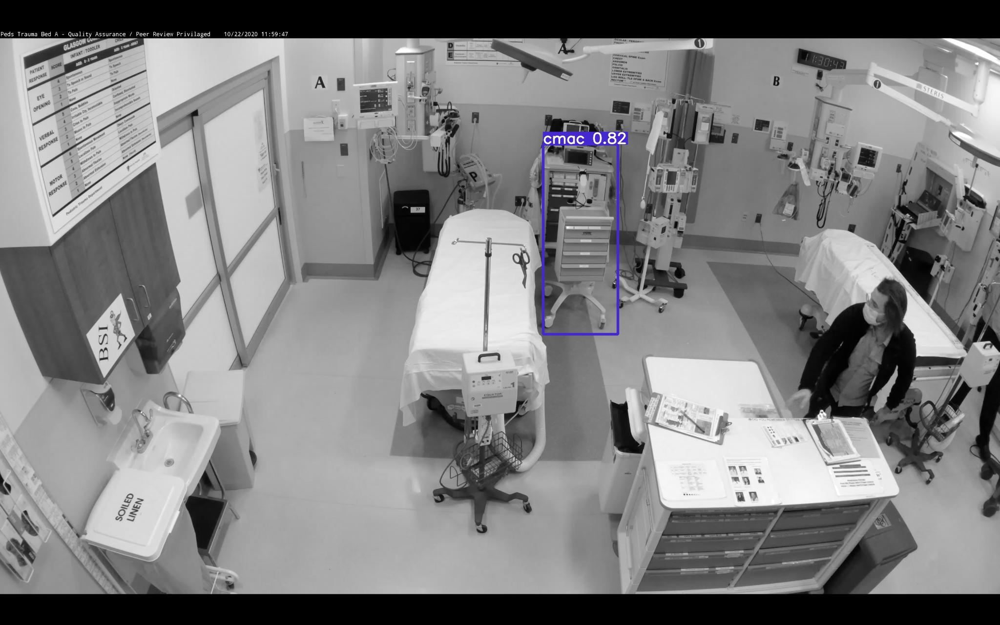

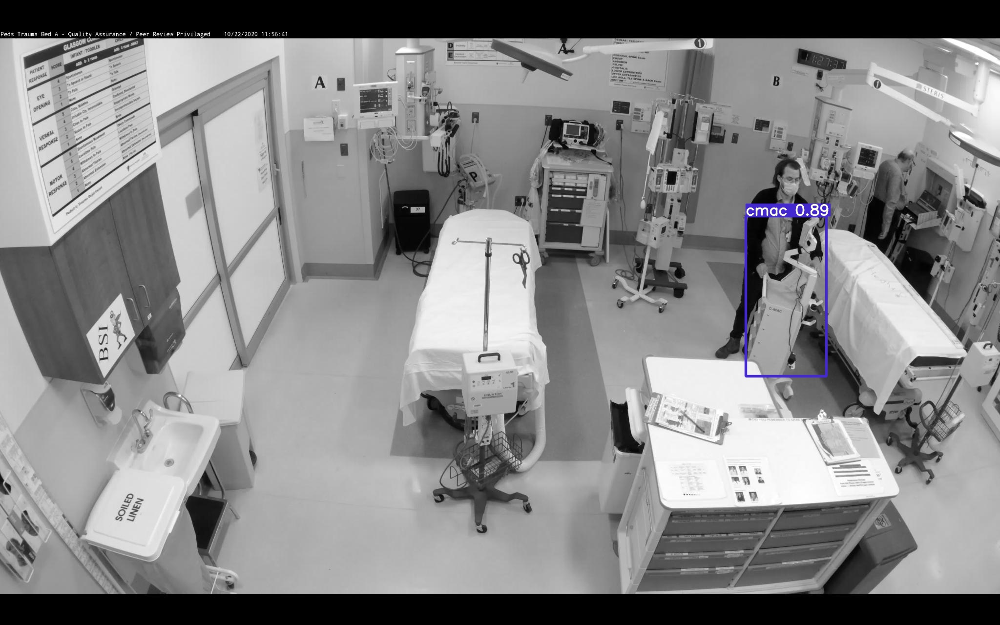

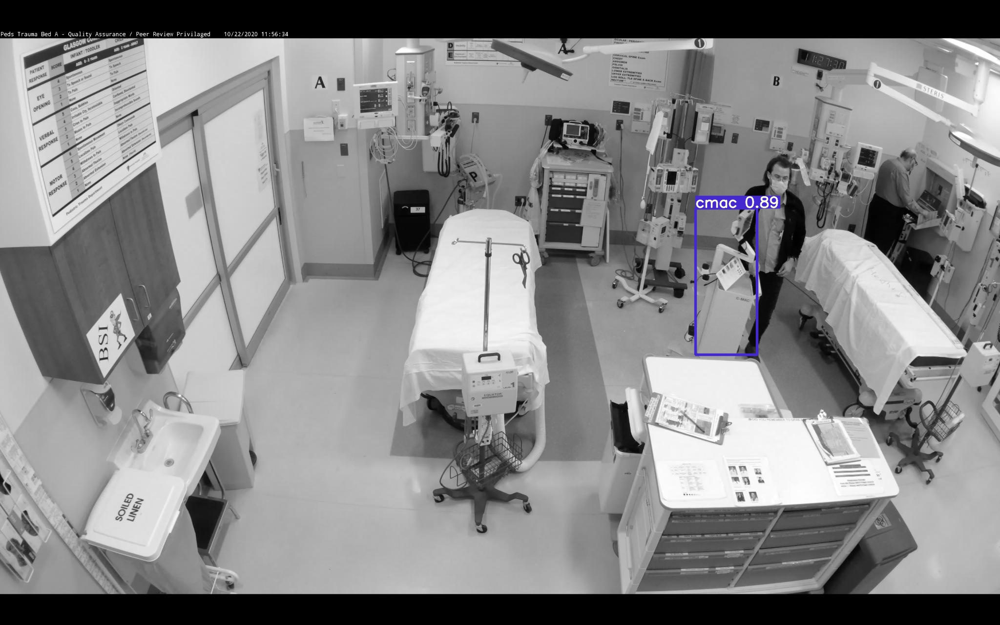

...

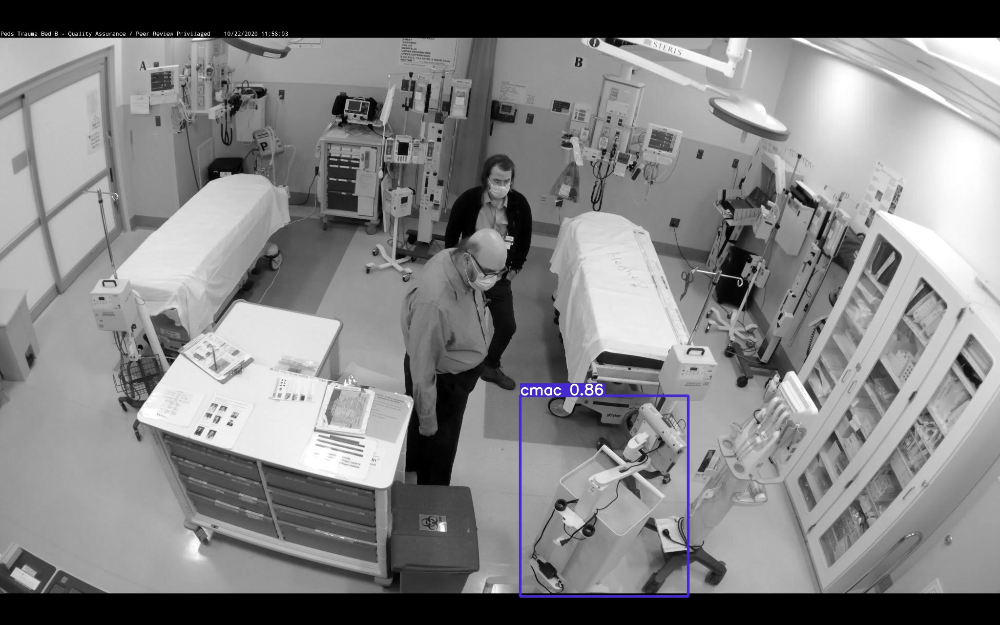

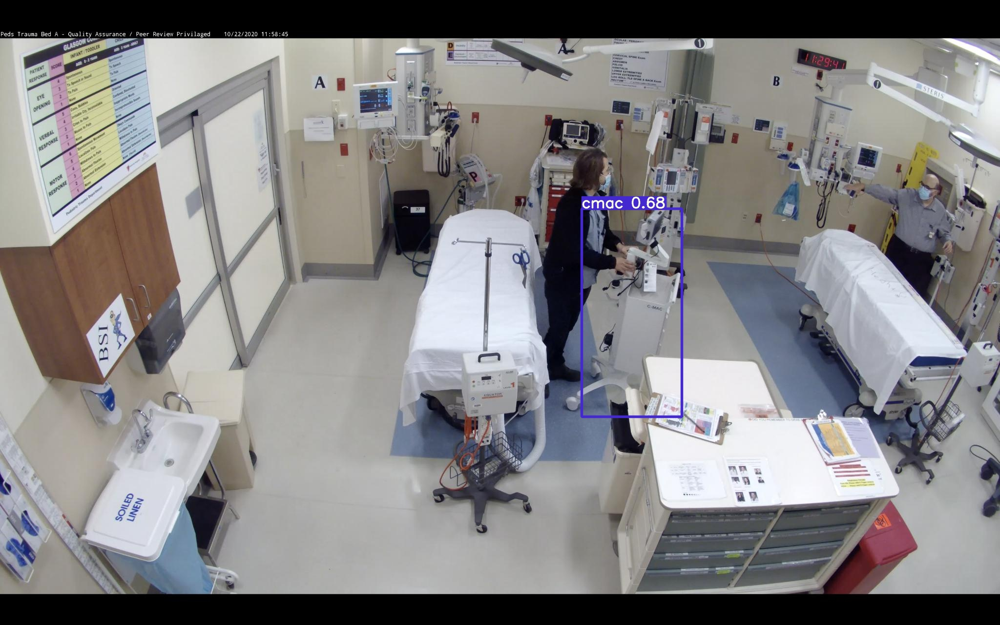

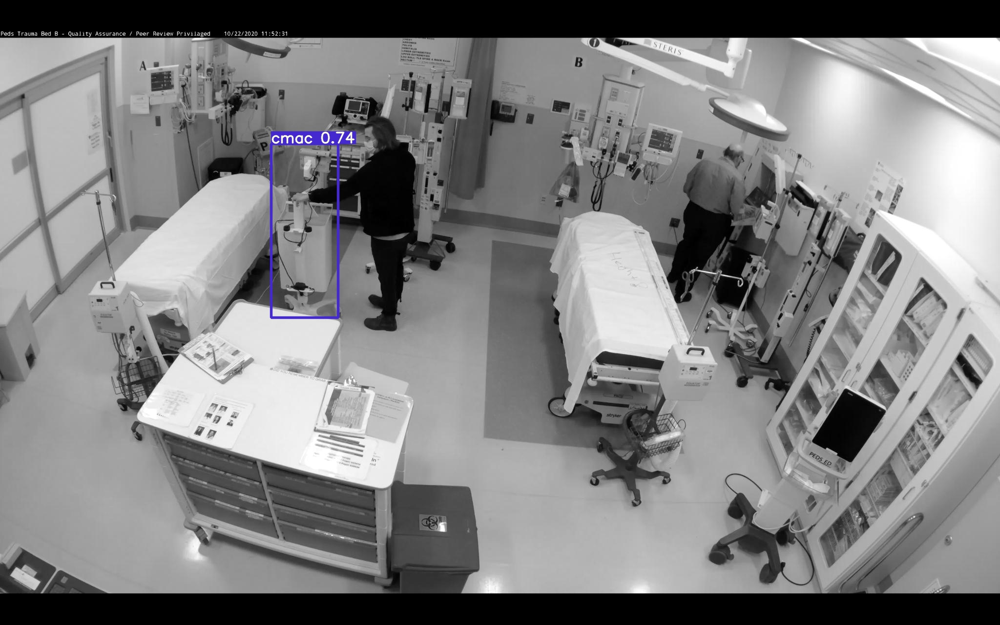

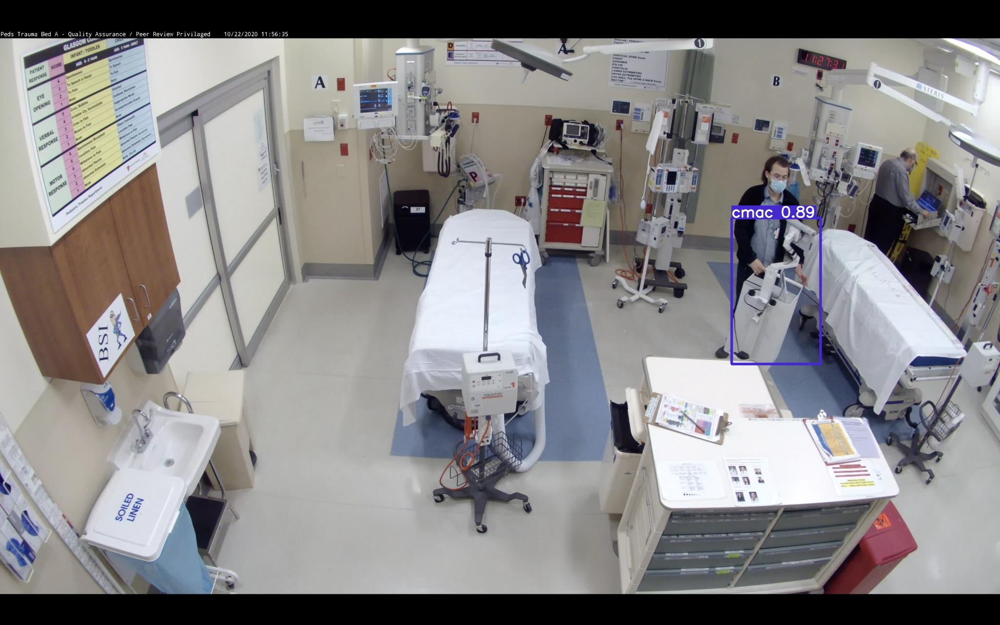

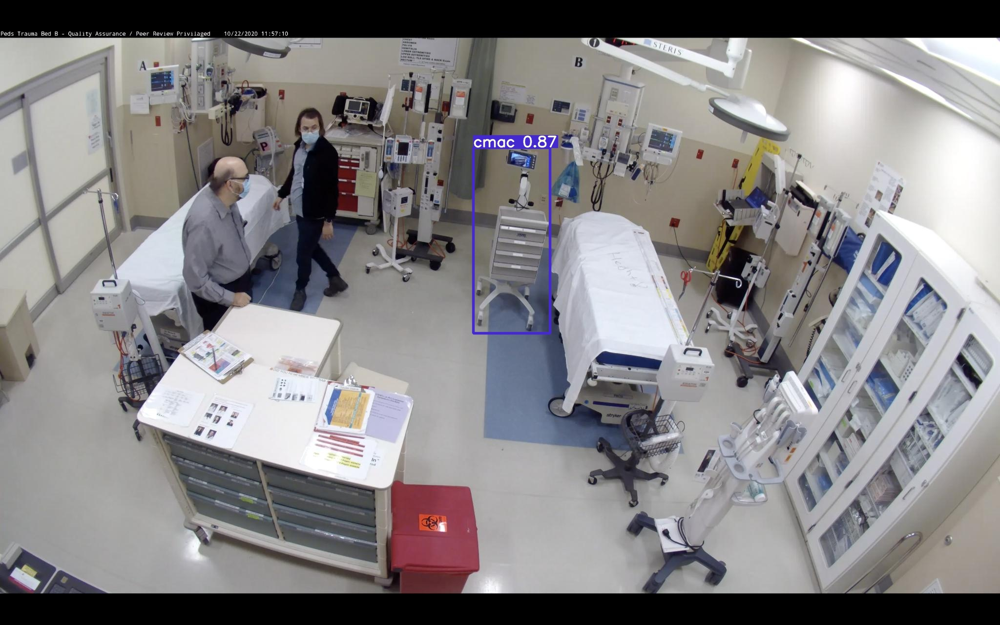

In [50]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/inference/output/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

#Save Model to gDrive

In [51]:
%cp /content/yolov5/runs/exp0_yolov5s_mayank/weights/best.pt /content/drive/My\ Drive/ObjectDetection/pretrained051120CNF08
%cp /content/yolov5/runs/exp0_yolov5s_mayank/weights/last.pt /content/drive/My\ Drive/ObjectDetection/pretrained051120CNF08

In [52]:
%cp /content/drive/My\ Drive/CMAC.mp4 /content/

In [53]:
%cd /content/yolov5/
!python detect.py --weights /content/yolov5/runs/exp7_yolov5s_mayank/weights/best.pt --img 416 --conf 0.70 --source /content/CMAC.mp4 --save-dir /content/output

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.7, device='', img_size=416, iou_thres=0.45, save_conf=False, save_dir='/content/output', save_txt=False, source='/content/CMAC.mp4', update=False, view_img=False, weights=['/content/yolov5/runs/exp7_yolov5s_mayank/weights/best.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15079MB)

Fusing layers... 
Model Summary: 284 layers, 8.83906e+07 parameters, 0 gradients
video 1/1 (1/2076) /content/CMAC.mp4: 256x416 Done. (0.032s)
video 1/1 (2/2076) /content/CMAC.mp4: 256x416 Done. (0.030s)
video 1/1 (3/2076) /content/CMAC.mp4: 256x416 Done. (0.030s)
video 1/1 (4/2076) /content/CMAC.mp4: 256x416 Done. (0.031s)
video 1/1 (5/2076) /content/CMAC.mp4: 256x416 Done. (0.030s)
video 1/1 (6/2076) /content/CMAC.mp4: 256x416 Done. (0.031s)
video 1/1 (7/2076) /content/CMAC.mp4: 256x416 Done. (0.029s)
video 1/1 (8/2076) /content/CMAC.mp4: 256x416 Done. (0.023s)
video 1/1 (9/2076) /content/C

In [55]:
# %rename /content/output/CMAC.mp4 /content/output/CMACoutput.mp4
%cp /content/output/CMACout.mp4 /content/drive/My\ Drive

In [ ]:
# from IPython.display import HTML
# from base64 import b64encode
# mp4 = open('/content/cmac_TuF7Mcp5.mp4','rb').read()
# data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
# HTML("""
# <video width=400 controls>
#       <source src="%s" type="video/mp4">
# </video>
# """ % data_url)

# !pip install -U kora  
from kora.drive import upload_public
url = upload_public('/content/output/final_5fa0c70907b84100629c1d5c_440777.mp4')
# then display it
from IPython.display import HTML
HTML(f"""<video src={url} width=500 controls/>""")

In [ ]:
from IPython.display import HTML
from base64 import b64encode
video_path = '/content/output/final_5fa0c70907b84100629c1d5c_440777.mp4'

mp4 = open(video_path,'rb').read()
decoded_vid = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML(f'<video width=400 controls><source src={decoded_vid} type="video/mp4"></video>')